https://www.kaggle.com/CooperUnion/anime-recommendations-database

# Anime Recommendation Database - Content Based
## Data file preparation 

## Import dataframe 'rating' - for anime that user has watched

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from pandas.io.parsers import read_csv
import seaborn as sns

In [11]:
anime = pd.read_csv('anime_data/anime.csv')
anime.head()

,anime_id,name,genre,type,episodes,rating,members
0,32281,Kimi no Na wa.,"Drama, Romance, School, Supernatural",Movie,1,9.37,200630
1,5114,Fullmetal Alchemist: Brotherhood,"Action, Adventure, Drama, Fantasy, Magic, Mili...",TV,64,9.26,793665
2,28977,Gintama°,"Action, Comedy, Historical, Parody, Samurai, S...",TV,51,9.25,114262
3,9253,Steins;Gate,"Sci-Fi, Thriller",TV,24,9.17,673572
4,9969,Gintama&#039;,"Action, Comedy, Historical, Parody, Samurai, S...",TV,51,9.16,151266


In [4]:
anime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12294 entries, 0 to 12293
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   anime_id  12294 non-null  int64  
 1   name      12294 non-null  object 
 2   genre     12232 non-null  object 
 3   type      12269 non-null  object 
 4   episodes  12294 non-null  object 
 5   rating    12064 non-null  float64
 6   members   12294 non-null  int64  
dtypes: float64(1), int64(2), object(4)
memory usage: 672.5+ KB


<AxesSubplot:>

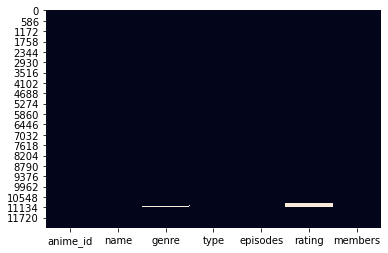

In [5]:
# remove null value 
sns.heatmap(anime.isnull(), cbar=False)

<AxesSubplot:>

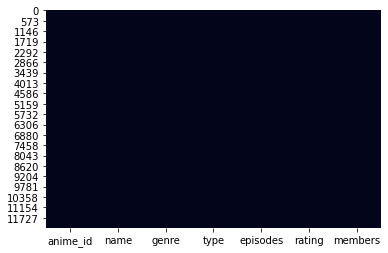

In [12]:
anime.dropna(inplace = True)
sns.heatmap(anime.isnull(), cbar=False)

## anime_genre.csv for distance calculation

In [13]:
# drop column of 'name', 'episodes' and 'members' 
anime_genre = anime.drop (['name','episodes','members'], axis = 1)

# feature extraction for 'genre', 'type' (Encode)
anime_gen = anime_genre['genre'].str.get_dummies(sep=',')
anime_type = pd.get_dummies(anime_genre[['type']])
anime_genre = anime_genre.drop (['genre', 'type'], axis = 1)
anime_genre = pd.concat([anime_genre,anime_gen,anime_type], axis=1)

# Scaling rating to 0 to 1 
anime_genre['rating']= anime_genre['rating']/10

#anime = anime.set_index('anime_id')
anime_genre.to_csv('anime_data/anime_preprocessed.csv', index = False)
anime_genre.head()

,anime_id,rating,Adventure,Cars,Comedy,Dementia,Demons,Drama,Ecchi,Fantasy,...,Supernatural,Thriller,Vampire,Yaoi,type_Movie,type_Music,type_ONA,type_OVA,type_Special,type_TV
0,32281,0.937,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,5114,0.926,1,0,0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,1
2,28977,0.925,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,9253,0.917,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4,9969,0.916,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


## anime.csv - information of individual anime

In [20]:
anime.head()

,anime_id,name,genre,type,episodes,rating,members
0,32281,Kimi no Na wa.,"Drama, Romance, School, Supernatural",Movie,1,9.37,200630
1,5114,Fullmetal Alchemist: Brotherhood,"Action, Adventure, Drama, Fantasy, Magic, Mili...",TV,64,9.26,793665
2,28977,Gintama°,"Action, Comedy, Historical, Parody, Samurai, S...",TV,51,9.25,114262
3,9253,Steins;Gate,"Sci-Fi, Thriller",TV,24,9.17,673572
4,9969,Gintama&#039;,"Action, Comedy, Historical, Parody, Samurai, S...",TV,51,9.16,151266


In [21]:
anime.drop (['type','episodes','members'], axis = 1, inplace= True)
anime

,anime_id,name,genre,rating
0,32281,Kimi no Na wa.,"Drama, Romance, School, Supernatural",9.37
1,5114,Fullmetal Alchemist: Brotherhood,"Action, Adventure, Drama, Fantasy, Magic, Mili...",9.26
2,28977,Gintama°,"Action, Comedy, Historical, Parody, Samurai, S...",9.25
3,9253,Steins;Gate,"Sci-Fi, Thriller",9.17
4,9969,Gintama&#039;,"Action, Comedy, Historical, Parody, Samurai, S...",9.16
...,...,...,...,...
12289,9316,Toushindai My Lover: Minami tai Mecha-Minami,Hentai,4.15
12290,5543,Under World,Hentai,4.28
12291,5621,Violence Gekiga David no Hoshi,Hentai,4.88
12292,6133,Violence Gekiga Shin David no Hoshi: Inma Dens...,Hentai,4.98


## rating.csv - carry user watching and rating record

In [22]:
rating = pd.read_csv('anime_data/rating.csv')
rating.head()

,user_id,anime_id,rating
0,1,20,-1
1,1,24,-1
2,1,79,-1
3,1,226,-1
4,1,241,-1


In [4]:
rating.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7813737 entries, 0 to 7813736
Data columns (total 3 columns):
 #   Column    Dtype
---  ------    -----
 0   user_id   int64
 1   anime_id  int64
 2   rating    int64
dtypes: int64(3)
memory usage: 178.8 MB


In [28]:
# No null value
rating.isnull().sum()

user_id     0
anime_id    0
rating      0
dtype: int64

# Recommendation by euclidean distance

In [79]:
from scipy.spatial.distance import euclidean

def anime_recommender(anime_id, N):
    # dataframe to store distance between animes 
    anime_distance = pd.DataFrame (data = anime.index)
    
    # drop row of the input anime_id
    anime_distance = anime_distance[anime.index != anime_id]
    
    # Calculate distance and store in distance columnm
    anime_distance['distance'] = anime_distance['anime_id'].apply(lambda x: euclidean(anime.loc[x],anime.loc[int(anime_id)]))
    anime_distance.sort_values(by='distance', inplace= True)
    
    return (anime_distance.head(N))

In [80]:
print (anime_recommender(28977,3))

       anime_id
0         32281
1          5114
2         28977
3          9253
4          9969
...         ...
12012      9316
12013      5543
12014      5621
12015      6133
12016     26081

[12017 rows x 1 columns]
    anime_id  distance
4       9969     0.009
9      15417     0.014
12       918     0.021
